In [44]:
import numpy as np
import matplotlib.pyplot as plt
from scipy.fftpack import dctn, idctn
from PIL import Image
import os

## Read Image

In [62]:
image = Image.open("image1.bmp")
# Split into Red, Green, and Blue channels
red, green, blue,alpha = image.split()

## showing results

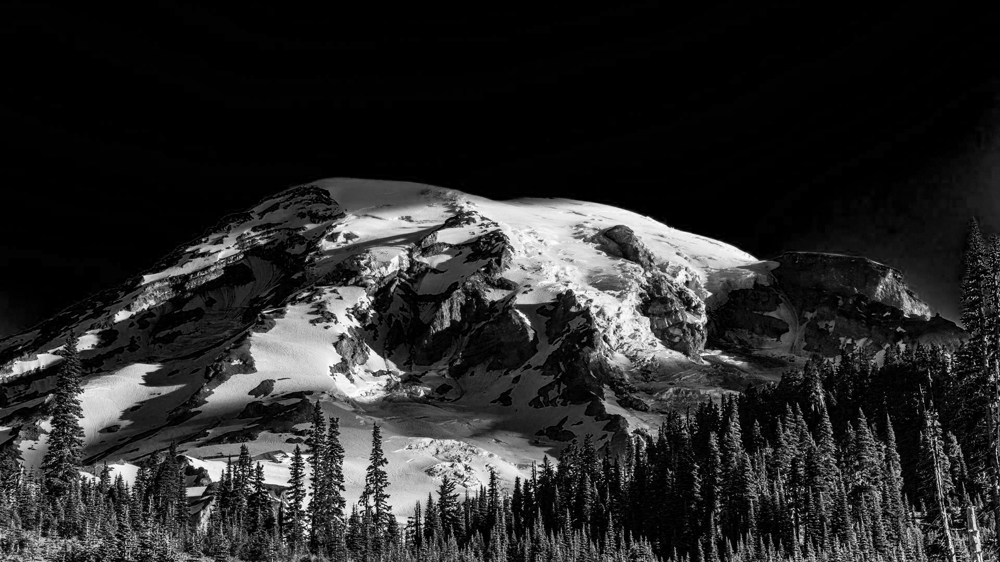

In [63]:
red

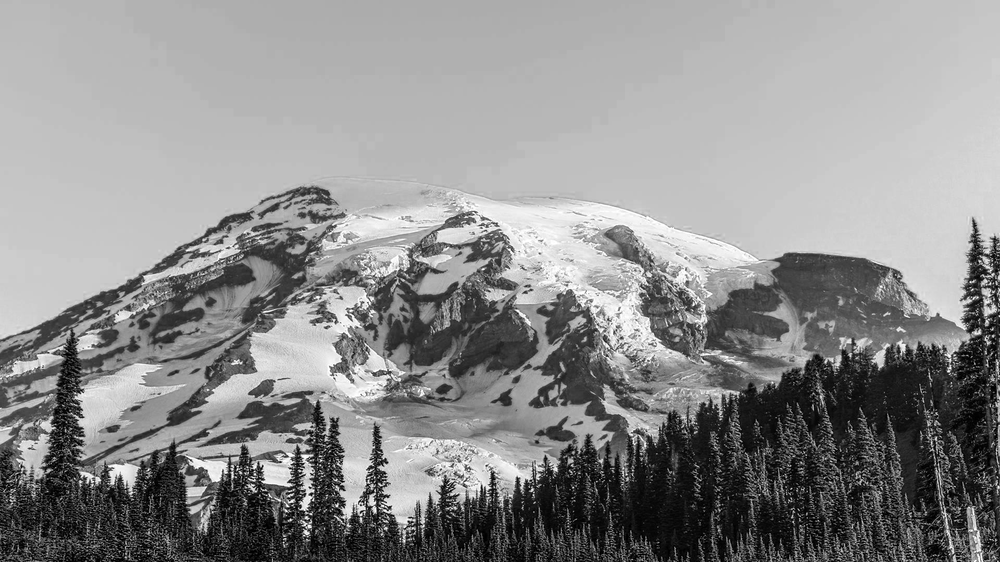

In [64]:
blue

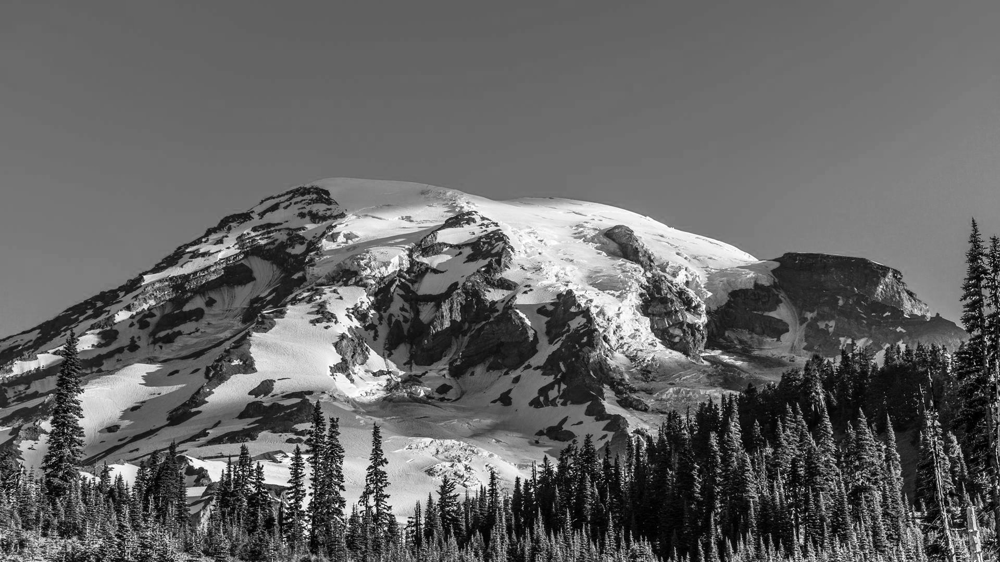

In [65]:
green

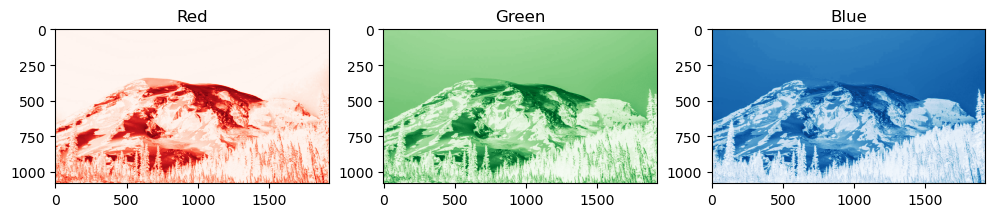

In [66]:
plt.figure(figsize=(12, 10))
plt.subplot(1, 3, 1)
plt.title("Red")
plt.imshow(red, cmap='Reds')

plt.subplot(1, 3, 2)
plt.title("Green")
plt.imshow(green, cmap='Greens')

plt.subplot(1, 3, 3)
plt.title("Blue")
plt.imshow(blue, cmap='Blues')

In [67]:
# Define the block size
BlockSize = 8  # Number of pixels in a block

# Get row and column sizes
rowSize = int(np.array(image).shape[0] / BlockSize)
colSize = int(np.array(image).shape[1] / BlockSize)

In [68]:
# Convert the image into numpy arrays for each color channel
red = np.array(red,dtype=np.float64)
green = np.array(green,dtype=np.float64)
blue = np.array(blue,dtype=np.float64)

In [69]:
RedListCompressed=[]
blueListCompressed=[]
greenListCompressed=[]
for m in range(1,5):
    redResultMatrix = np.zeros((m*rowSize,m*colSize),dtype=np.float64)
    greenResultMatrix = np.zeros((m*rowSize,m*colSize),dtype=np.float64) 
    blueResultMatrix = np.zeros((m*rowSize,m*colSize),dtype=np.float64)  
    for i in range(0, rowSize):
        Rstepindex=i*BlockSize
        RM=i*m
        for j in range(0,colSize):
            Cstepindex=j*BlockSize
            MC=j*m
            blockred = red[Rstepindex:Rstepindex+BlockSize, Cstepindex:Cstepindex+BlockSize]
            blockgreen = green[Rstepindex:Rstepindex+BlockSize, Cstepindex:Cstepindex+BlockSize]
            blockblue = blue[Rstepindex:Rstepindex+BlockSize, Cstepindex:Cstepindex+BlockSize]
            
            dct_block_red = dctn(blockred, norm='ortho')
            dct_block_green = dctn(blockgreen, norm='ortho')
            dct_block_blue = dctn(blockblue, norm='ortho')
            
            truncated_dct_block_red = dct_block_red[:m, :m]
            truncated_dct_block_green = dct_block_green[:m, :m]
            truncated_dct_block_blue = dct_block_blue[:m, :m]
            
            redResultMatrix[RM:RM+m, MC:MC+m]=truncated_dct_block_red
            greenResultMatrix[RM:RM+m, MC:MC+m]=truncated_dct_block_green
            blueResultMatrix[RM:RM+m, MC:MC+m]=truncated_dct_block_blue
            
    
    RedListCompressed.append(redResultMatrix)
    greenListCompressed.append(greenResultMatrix)
    blueListCompressed.append(blueResultMatrix)
   

In [70]:
Reconstructed_Compressed_images=[]
for i in range(len(RedListCompressed)):
    Reconstructed_Compressed_images.append( Image.merge("RGB", (
        Image.fromarray(RedListCompressed[i]).convert("L"),
        Image.fromarray(greenListCompressed[i]).convert("L"),
        Image.fromarray(blueListCompressed[i]).convert("L"),
    )))

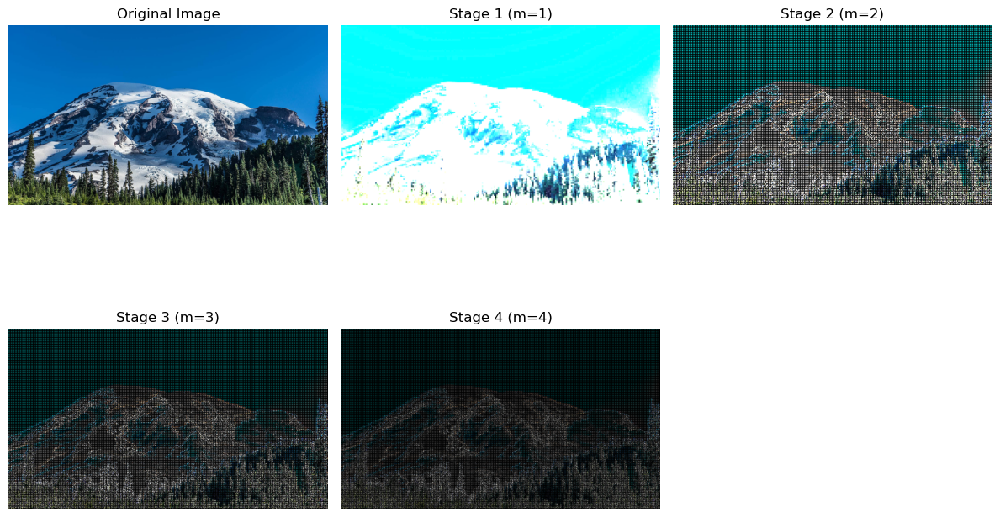

In [71]:
# Visualize the reconstructed images for each stage
plt.figure(figsize=(12, 8))
plt.subplot(231)
plt.imshow(image)
plt.title("Original Image")
plt.axis("off")

for i, m in enumerate([1, 2, 3, 4]):
    plt.subplot(2, 3, i + 2)    
    plt.imshow(Reconstructed_Compressed_images[i])
    plt.title(f"Stage {m} (m={m})")
    plt.axis("off")

plt.tight_layout()
plt.show()

In [72]:
compressed_image_paths = []
compressed_image_sizes = []
for i in range(len(Reconstructed_Compressed_images)):
    
    compressed_image_path = f"compressed_result_{i}.bmp"
    Reconstructed_Compressed_images[i].save(compressed_image_path, "BMP")
    compressed_image_paths.append(compressed_image_path)
    
    # Get the file size
    file_size = os.path.getsize(compressed_image_path)
    compressed_image_sizes.append(file_size)
print(compressed_image_sizes)  # sizes of compressed images in bytes
print(os.path.getsize("image1.bmp"))

[97254, 388854, 874854, 1555254]
8294538


## Reconstruct

In [76]:
RedListUnCompressed=[]
blueListUnCompressed=[]
greenListUnCompressed=[]
for m in range(1,5):
    redResultMatrix = np.zeros_like(red,dtype=np.float64)
    greenResultMatrix = np.zeros_like(green,dtype=np.float64) 
    blueResultMatrix = np.zeros_like(blue,dtype=np.float64)  
    for i in range(0, rowSize):
        Rstepindex=i*BlockSize
        RM=i*m
        for j in range(0,colSize):
            Cstepindex=j*BlockSize
            MC=j*m
            
            idct_block_red = idctn(RedListCompressed[m-1][RM:RM+m, MC:MC+m], norm='ortho', shape=(BlockSize, BlockSize))
            idct_block_green = idctn(greenListCompressed[m-1][RM:RM+m, MC:MC+m], norm='ortho', shape=(BlockSize, BlockSize))
            idct_block_blue = idctn(blueListCompressed[m-1][RM:RM+m, MC:MC+m], norm='ortho', shape=(BlockSize, BlockSize))

            
            redResultMatrix[Rstepindex:Rstepindex+BlockSize, Cstepindex:Cstepindex+BlockSize] = idct_block_red
            greenResultMatrix[Rstepindex:Rstepindex+BlockSize, Cstepindex:Cstepindex+BlockSize] = idct_block_green
            blueResultMatrix[Rstepindex:Rstepindex+BlockSize, Cstepindex:Cstepindex+BlockSize] = idct_block_blue
            
    
    RedListUnCompressed.append(redResultMatrix)
    blueListUnCompressed.append(blueResultMatrix)
    greenListUnCompressed.append(greenResultMatrix)

In [77]:
Reconstructed_UnCompressed_images=[]
for i in range(len(RedListCompressed)):
    Reconstructed_UnCompressed_images.append( Image.merge("RGB", (
        Image.fromarray(RedListUnCompressed[i]).convert("L"),
        Image.fromarray(greenListUnCompressed[i]).convert("L"),
        Image.fromarray(blueListUnCompressed[i]).convert("L"),
    )))

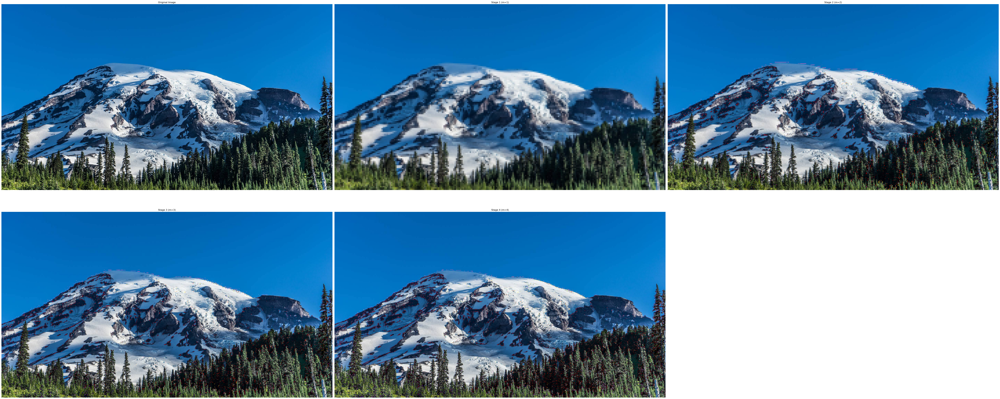

In [78]:
plt.figure(figsize=(70, 30))
plt.subplot(231)
plt.imshow(image)
plt.title("Original Image")
plt.axis("off")

for i, m in enumerate([1, 2, 3, 4]):
    plt.subplot(2, 3, i + 2)

    plt.imshow(Reconstructed_UnCompressed_images[i])
    plt.title(f"Stage {m} (m={m})")
    plt.axis("off")

plt.tight_layout()
plt.show()

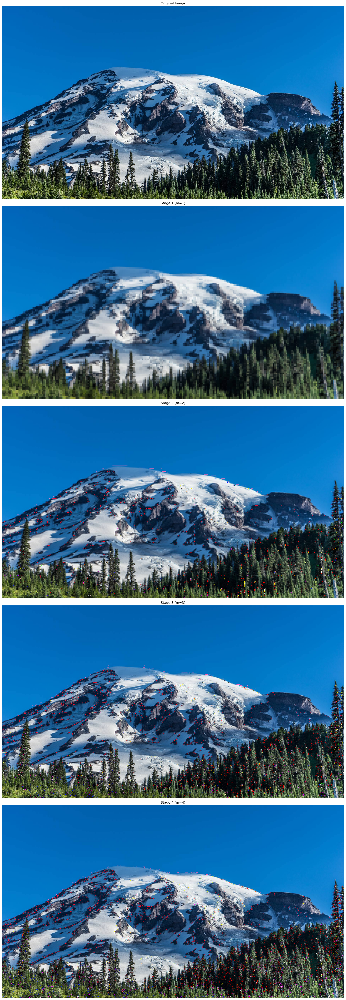

In [14]:
plt.figure(figsize=(30, 50))  # 30x50 to allow large individual plots

# Number of subplots and the column layout (1 column, 5 rows)
total_subplots = 5
for idx in range(total_subplots):
    plt.subplot(total_subplots, 1, idx + 1)  # 5 rows, 1 column
    
    if idx == 0:
        # Plot the original image (dummy example, replace with your own)
        plt.imshow(image)
        plt.title("Original Image")
        plt.axis("off")
    else:
        # Plot the reconstructed images based on compressed data
        m = idx
        reconstructed_image = Image.merge("RGB", (
            Image.fromarray(RedListUnCompressed[idx - 1]).convert("L"),
            Image.fromarray(greenListUnCompressed[idx - 1]).convert("L"),
            Image.fromarray(blueListUnCompressed[idx - 1]).convert("L"),
        ))
        plt.imshow(reconstructed_image)
        plt.title(f"Stage {m} (m={m})")
    
    plt.axis("off")  # Hide the axes for cleaner presentation

# Ensure plots do not overlap and display
plt.tight_layout()
plt.show()

In [27]:
Uncompressed_image_paths = []
Uncompressed_image_sizes = []
for i in range(len(Reconstructed_UnCompressed_images)):
    
    Uncompressed_image_path = f"Uncompressed_result_{i}.bmp"
    Reconstructed_UnCompressed_images[i].save(Uncompressed_image_path, "BMP")
    Uncompressed_image_paths.append(Uncompressed_image_path)
    
    # Get the file size
    file_size = os.path.getsize(Uncompressed_image_path)
    Uncompressed_image_sizes.append(file_size)
print(Uncompressed_image_sizes)  # sizes of compressed images in bytes
print(os.path.getsize("image1.bmp"))

[6220854, 6220854, 6220854, 6220854]
8294538


## MSE

In [ ]:
# Define a function to calculate Peak Signal-to-Noise Ratio (PSNR)
def psnr(image1, image2):
    # Calculate Mean Squared Error (MSE)
    mse = np.mean((image1 - image2) ** 2)
    
    # Maximum pixel value (assuming pixel values are in the range [0, 255])
    max_pixel_value = 255
    
    # Calculate PSNR using the formula: PSNR = 10 * log10((max_pixel_value ** 2) / MSE)
    psnr = 10 * np.log10((max_pixel_value ** 2) / mse)
    
    return psnr

# List to store PSNR values for each decompressed image
PSNRVALUES = []

# Convert the original image to grayscale
image_gc = cv2.cvtColor(np.array(image), cv2.COLOR_BGR2GRAY)

# Iterate over the decompressed images
for i in range(len(Reconstructed_UnCompressed_images)):
    # Convert the current decompressed image to grayscale
    decompressed_image_gc = cv2.cvtColor(np.array(Reconstructed_UnCompressed_images[i]), cv2.COLOR_BGR2GRAY)
    
    # Calculate PSNR between the grayscale original image and the current grayscale decompressed image
    psnr_value = psnr(image_gc, decompressed_image_gc)
    
    # Append the calculated PSNR value to the list
    PSNRVALUES.append(psnr_value)
# Print PSNR values for each decompressed image
for idx, psnr_value in enumerate(PSNRVALUES):
    print(f"PSNR between original image and decompressed image with m={idx + 1}: {psnr_value}")

In [ ]:
compressed_image_paths = []
compressed_image_sizes = []
for i in range(len(Reconstructed_Compressed_images)):
    
    compressed_image_path = f"compressed_result_{i}.bmp"
    Reconstructed_Compressed_images[i].save(compressed_image_path, "BMP")
    compressed_image_paths.append(compressed_image_path)
    
    # Get the file size
    file_size = os.path.getsize(compressed_image_path)
    compressed_image_sizes.append(file_size)
print(compressed_image_sizes)  # sizes of compressed images in bytes
print(os.path.getsize("image1.bmp"))
plt.figure(figsize=(10, 5))
plt.bar(range(len(compressed_image_sizes)), compressed_image_sizes, color='red', label='Compressed')
plt.axhline(y=os.path.getsize("image1.bmp"), color='blue', linestyle='--', label='Original')
plt.xlabel('Image')
plt.ylabel('File Size (bytes)')
plt.title('Comparison of Image Sizes')
plt.xticks(range(len(compressed_image_sizes)), [f"BlockSize(M)={i+1}" for i in range(len(compressed_image_sizes))])
plt.legend()
plt.show()

In [ ]:
m_values = [1, 2, 3, 4]
plt.plot(m_values, PSNRVALUES, marker='o')

# Add labels and title
plt.xlabel('m (block size)')
plt.ylabel('PSNR')
plt.title('PSNR vs m')

# Show the plot
plt.grid(True)
plt.show()

As 
𝑚
m increases (from 1 to 4), the PSNR value also increases steadily.So we Notice that increasing the block size generally improves the quality of the decompressed images.
The increase in PSNR indicates that larger block sizes capture more spatial redundancy in the image, leading to better compression efficiency and, consequently, higher quality reconstructed images.